In [8]:
import numpy as np
import matplotlib.pyplot as plt
import physt
from scipy import optimize
import os
print(os.getcwd())

/media/ebeyerle/ducks2/1mus/0.2ps_step/PCA


In [20]:
data5 = np.loadtxt('nonorm_deltar_2exp.dat')
data6 = np.loadtxt('nonorm_deltar_2exp_HA.dat')

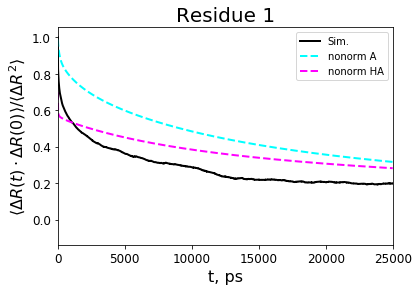

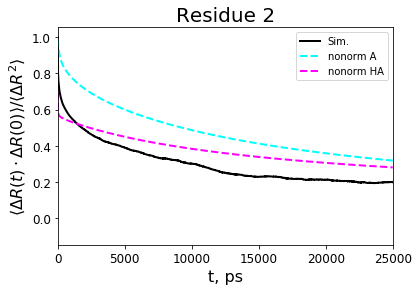

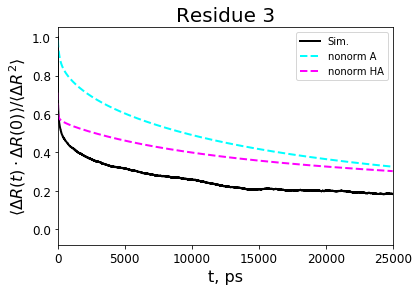

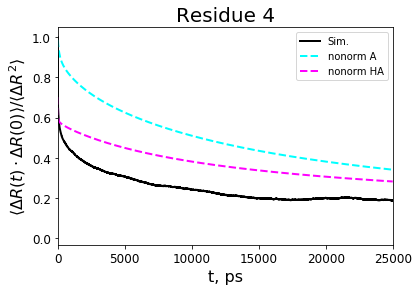

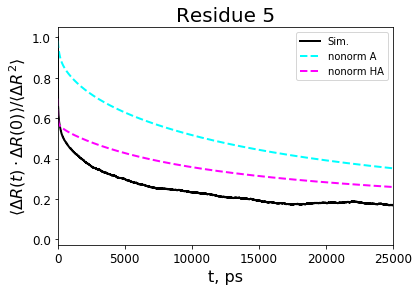

...

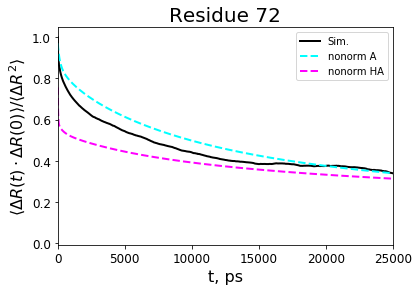

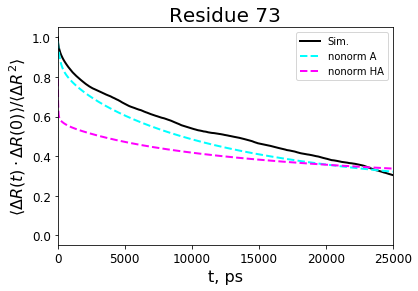

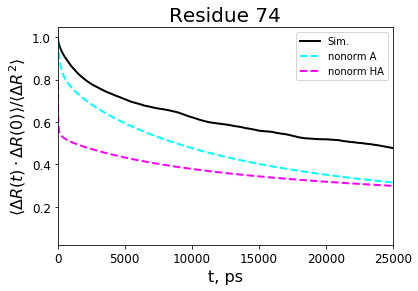

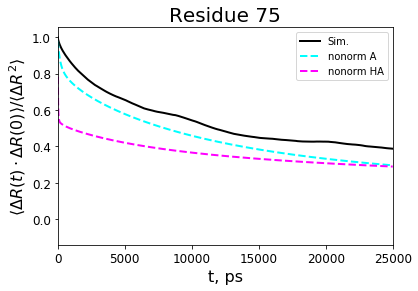

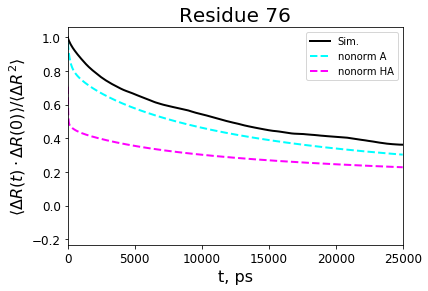

In [11]:
#Compare fits

slices = [10,50,100,200,1000]

colors = plt.cm.cool(np.linspace(0,1,len(slices)))
for i in range(76):
    data1 = []
    data2 = []
    with open('tcf_deltar_'+str(i+1),'rb') as f:
        for line in f:
                if len(line.split()) != 2:
                    pass
                else:
                    data1.append(2*float(line.split()[0]))
                    data2.append(float(line.split()[1]))
    data1 = np.column_stack([data1,data2])
    #data2 = np.loadtxt(str(t)+'ns/m1int_'+str(i))
    #data3 = np.loadtxt('2exp_m1int_'+str(i))

    plt.plot(data1[:,0],data1[:,1],lw=2,c='k',label='Sim.')
    #plt.plot(data2[:,0],data2[:,1],lw=2,c='r',ls='--')
    #plt.plot(data1[:,0],data3[:,i],lw=2,c=colors[0],ls='--',label='A')
    #plt.plot(data1[:,0],data4[:,i],lw=2,c=colors[-1],ls='--',label='HA')
    plt.plot(data1[:,0],data5[:,i],lw=2,c=colors[0],ls='--',label='nonorm A')
    plt.plot(data1[:,0],data6[:,i],lw=2,c=colors[-1],ls='--',label='nonorm HA')

    plt.title('Residue '+str(i+1),fontsize=20)
    plt.xlim(0,25000)
    plt.xticks(size=12)
    plt.yticks(size=12)
    plt.xlabel('t, ps',fontsize=16)
    plt.ylabel(r'$\langle\Delta R(t) \cdot \Delta R(0)\rangle/\langle\Delta R^2\rangle$',fontsize=16)
    plt.legend()
    plt.show()
    plt.close()

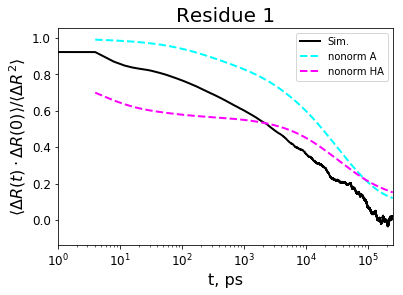

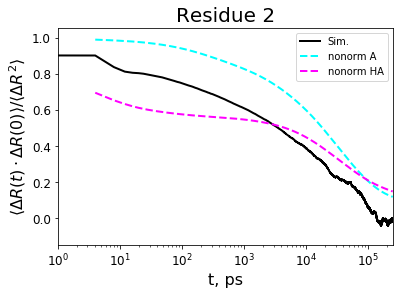

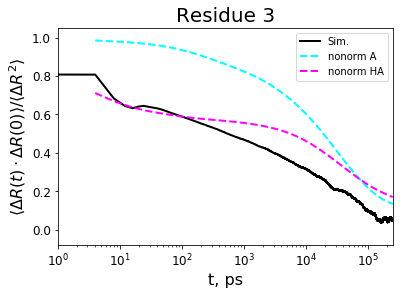

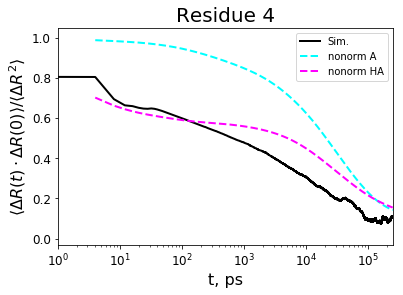

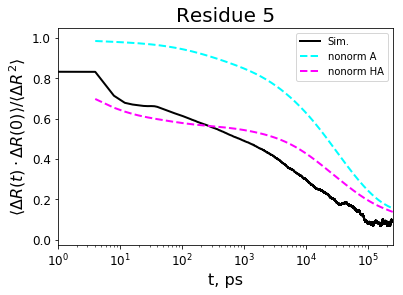

...

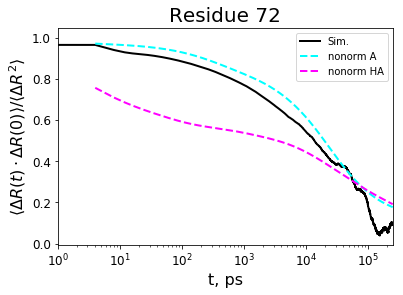

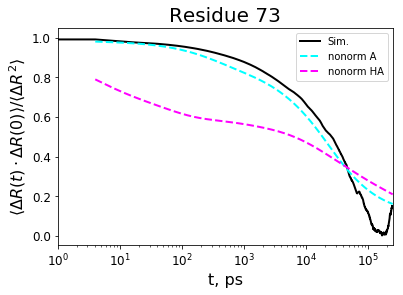

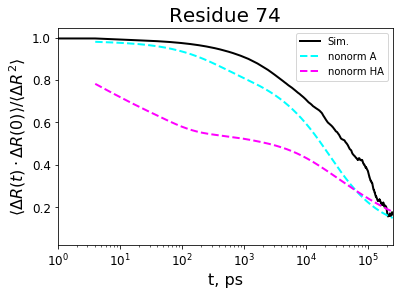

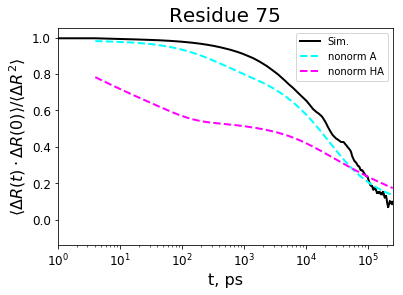

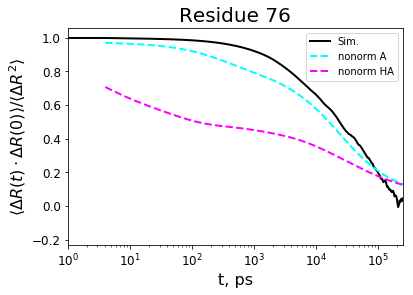

In [15]:
#Plot logarithmically

slices = [10,50,100,200,1000]

colors = plt.cm.cool(np.linspace(0,1,len(slices)))
for i in range(76):
    data1 = []
    data2 = []
    with open('tcf_deltar_'+str(i+1),'rb') as f:
        for line in f:
                if len(line.split()) != 2:
                    pass
                else:
                    data1.append(2*float(line.split()[0]))
                    data2.append(float(line.split()[1]))
    data1 = np.column_stack([data1,data2])
    #data2 = np.loadtxt(str(t)+'ns/m1int_'+str(i))
    #data3 = np.loadtxt('2exp_m1int_'+str(i))

    plt.plot(data1[:,0],data1[:,1],lw=2,c='k',label='Sim.')
    #plt.plot(data2[:,0],data2[:,1],lw=2,c='r',ls='--')
    #plt.plot(data1[:,0],data3[:,i],lw=2,c=colors[0],ls='--',label='A')
    #plt.plot(data1[:,0],data4[:,i],lw=2,c=colors[-1],ls='--',label='HA')
    plt.plot(data1[:,0],data5[:,i],lw=2,c=colors[0],ls='--',label='nonorm A')
    plt.plot(data1[:,0],data6[:,i],lw=2,c=colors[-1],ls='--',label='nonorm HA')

    plt.title('Residue '+str(i+1),fontsize=20)
    plt.xticks(size=12)
    plt.yticks(size=12)
    plt.xlabel('t, ps',fontsize=16)
    plt.ylabel(r'$\langle\Delta R(t) \cdot \Delta R(0)\rangle/\langle\Delta R^2\rangle$',fontsize=16)
    plt.xlim(1,250000)
    plt.xscale('log')
    plt.legend()
    plt.show()
    plt.close()

In [18]:
#Plot the average
nfrs = 125000
avgtcf = np.zeros((nfrs,2))
for i in range(76):
    data1 = []
    data2 = []
    with open('tcf_deltar_'+str(i+1),'rb') as f:
        for line in f:
                if len(line.split()) != 2:
                    pass
                else:
                    data1.append(2*float(line.split()[0]))
                    data2.append(float(line.split()[1]))
    avgtcf += np.column_stack([data1,data2])
avgtcf = avgtcf/76

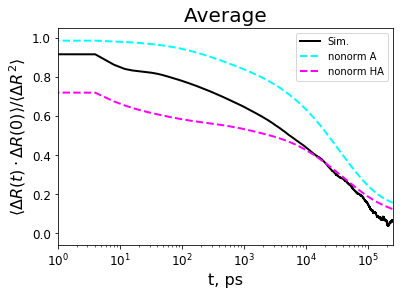

In [21]:
plt.plot(avgtcf[:,0],avgtcf[:,1],lw=2,c='k',label='Sim.')
#plt.plot(data2[:,0],data2[:,1],lw=2,c='r',ls='--')
#plt.plot(data1[:,0],data3[:,i],lw=2,c=colors[0],ls='--',label='A')
#plt.plot(data1[:,0],data4[:,i],lw=2,c=colors[-1],ls='--',label='HA')
plt.plot(avgtcf[:,0],data5.mean(1),lw=2,c=colors[0],ls='--',label='nonorm A')
plt.plot(avgtcf[:,0],data6.mean(1),lw=2,c=colors[-1],ls='--',label='nonorm HA')

plt.title('Average',fontsize=20)
plt.xlim(0,250000)
plt.xticks(size=12)
plt.yticks(size=12)
plt.xlabel('t, ps',fontsize=16)
plt.ylabel(r'$\langle\Delta R(t) \cdot \Delta R(0)\rangle/\langle\Delta R^2\rangle$',fontsize=16)
plt.xlim(1,250000)
plt.xscale('log')
plt.legend()
plt.savefig('average_tcf_deltar_fit.pdf',dpi=300)
plt.show()
plt.close()

In [ ]:
plt.plot(avgtcf[:,0],avgtcf[:,1],lw=2,c='k',label='Sim.')
#plt.plot(data2[:,0],data2[:,1],lw=2,c='r',ls='--')
#plt.plot(data1[:,0],data3[:,i],lw=2,c=colors[0],ls='--',label='A')
#plt.plot(data1[:,0],data4[:,i],lw=2,c=colors[-1],ls='--',label='HA')
plt.plot(avgtcf[:,0],data5.mean(1),lw=2,c=colors[0],ls='--',label='nonorm A')
plt.plot(avgtcf[:,0],data6.mean(1),lw=2,c=colors[-1],ls='--',label='nonorm HA')

plt.title('Average',fontsize=20)
plt.xlim(0,250000)
plt.xticks(size=12)
plt.yticks(size=12)
plt.xlabel('t, ps',fontsize=16)
plt.ylabel(r'$\langle\Delta R(t) \cdot \Delta R(0)\rangle/\langle\Delta R^2\rangle$',fontsize=16)
#plt.xscale('log')
plt.legend()
plt.show()
plt.close()

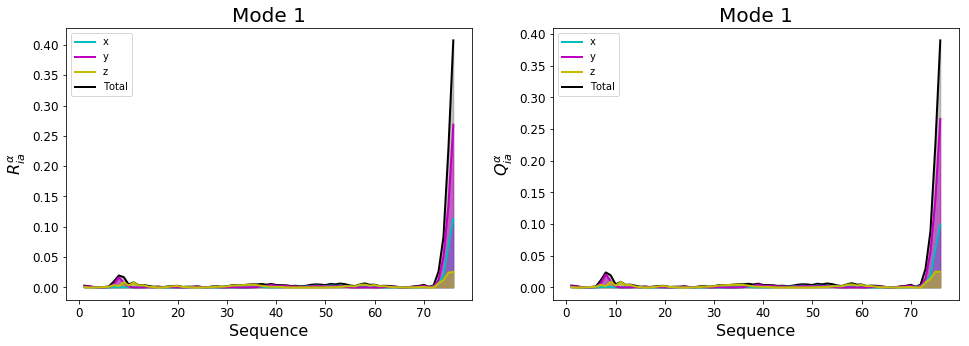

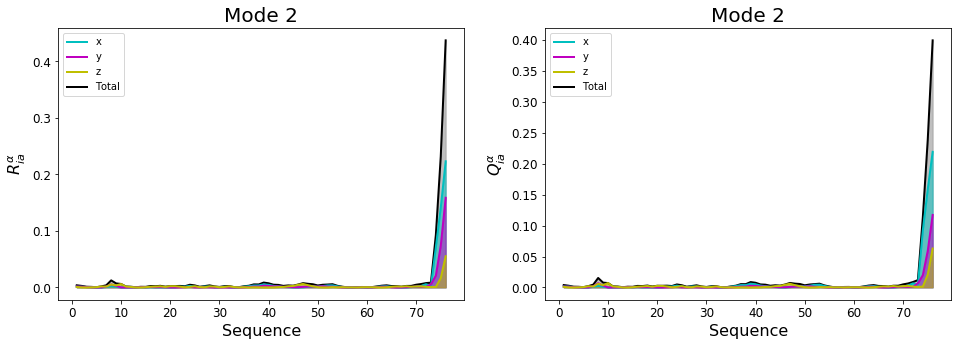

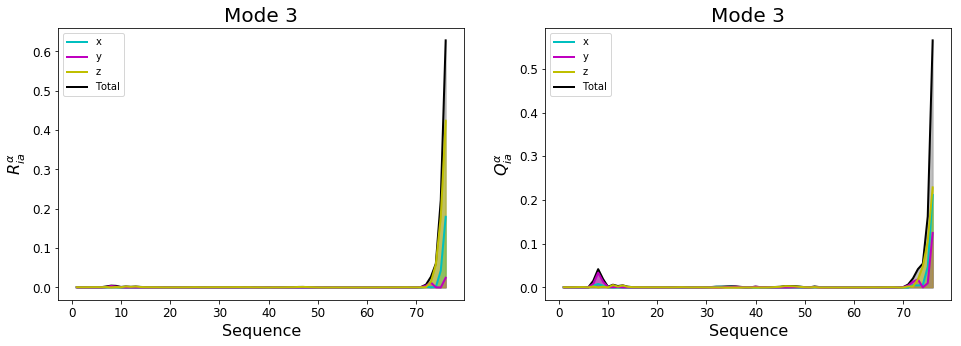

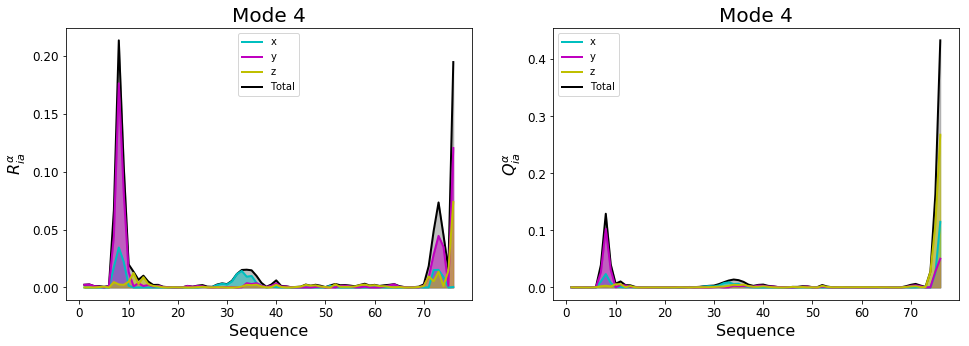

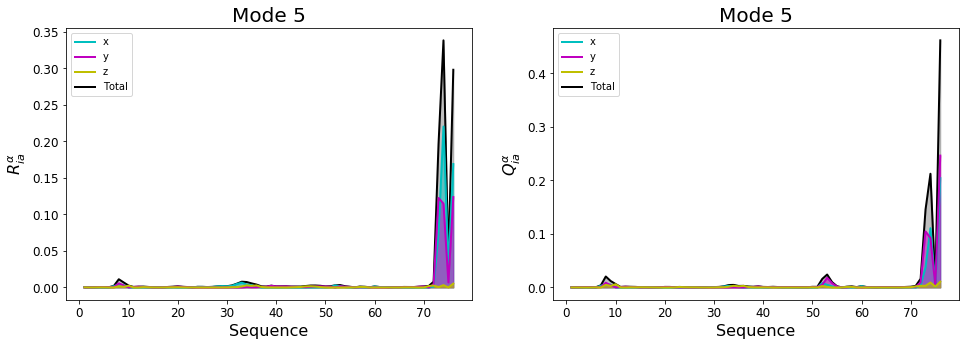

...

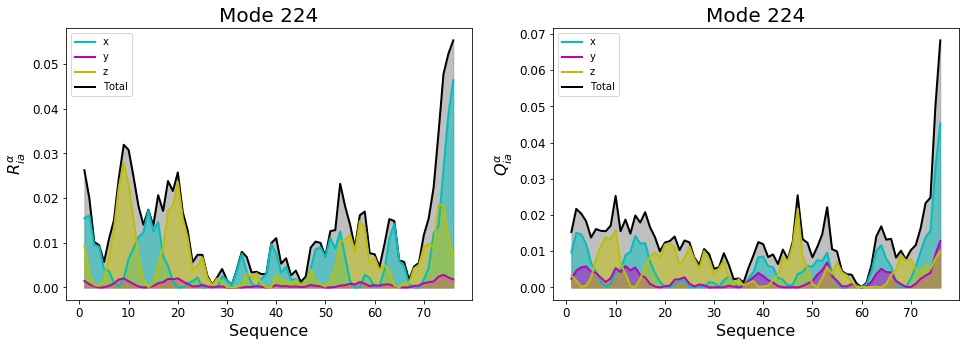

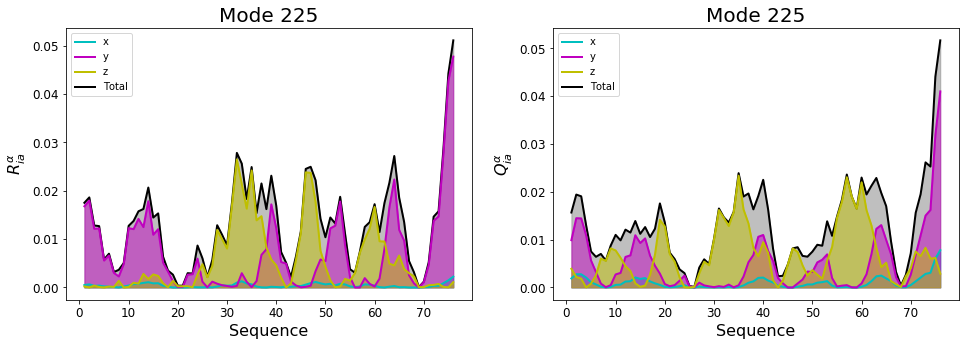

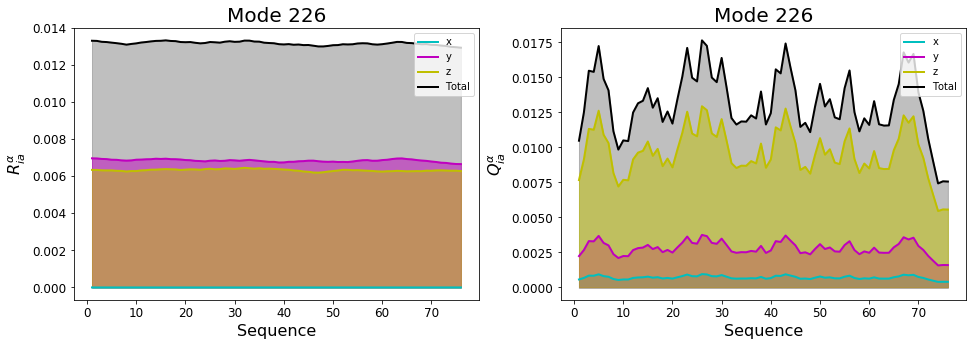

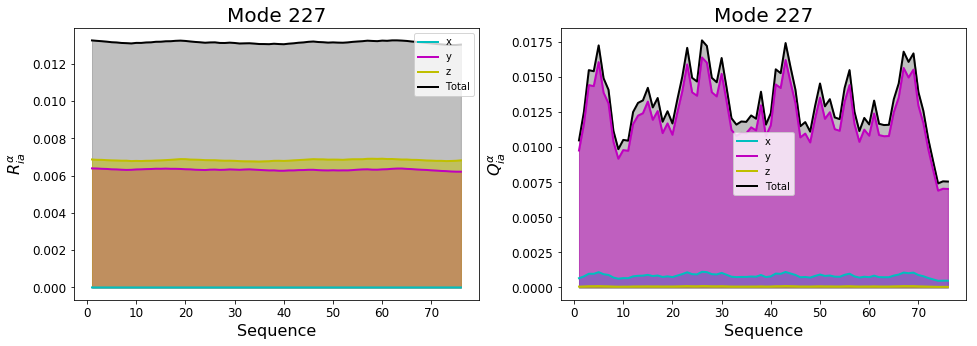

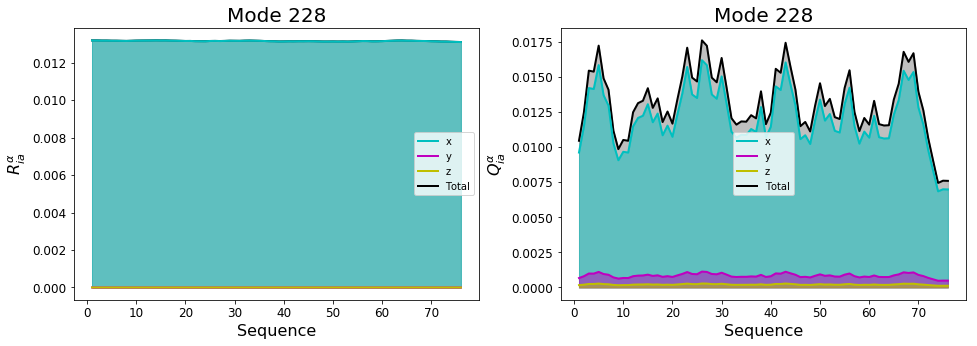

In [2]:
N = 76

R = np.reshape(np.loadtxt('com_Rmatrix'),(3*N,3*N))
Q = np.reshape(np.loadtxt('com_HCmatrix'),(3*N,3*N))

#Visualize fluctuations

for i in range(Q.shape[0]):
    plt.figure(figsize=(16,5))
    plt.subplot(121)

    plt.plot(np.arange(1,77),R[0::3,i]**2,c='c',lw=2,label='x')
    plt.fill_between(np.arange(1,77),0,R[0::3,i]**2,color='c',alpha=0.5)
    plt.plot(np.arange(1,77),R[1::3,i]**2,c='m',lw=2,label='y')
    plt.fill_between(np.arange(1,77),0,R[1::3,i]**2,color='m',alpha=0.5)
    plt.plot(np.arange(1,77),R[2::3,i]**2,c='y',lw=2,label='z')
    plt.fill_between(np.arange(1,77),0,R[2::3,i]**2,color='y',alpha=0.5)
    plt.plot(np.arange(1,77),R[0::3,i]**2 + R[1::3,i]**2 + R[2::3,i]**2,c='k',lw=2,label='Total',zorder=-10)
    plt.fill_between(np.arange(1,77),0,R[0::3,i]**2 + R[1::3,i]**2 + R[2::3,i]**2,color='grey',alpha=0.5,zorder=-10)
    plt.title('Mode '+str(i+1),fontsize=20)
    plt.xlabel('Sequence',fontsize=16)
    plt.ylabel(r'$R^{\alpha}_{ia}$',fontsize=16)
    plt.xticks(size=12)
    plt.yticks(size=12)
    plt.legend()
    
    plt.subplot(122)
    plt.plot(np.arange(1,77),Q[0::3,i]**2,c='c',lw=2,label='x')
    plt.fill_between(np.arange(1,77),0,Q[0::3,i]**2,color='c',alpha=0.5)
    plt.plot(np.arange(1,77),Q[1::3,i]**2,c='m',lw=2,label='y')
    plt.fill_between(np.arange(1,77),0,Q[1::3,i]**2,color='m',alpha=0.5)
    plt.plot(np.arange(1,77),Q[2::3,i]**2,c='y',lw=2,label='z')
    plt.fill_between(np.arange(1,77),0,Q[2::3,i]**2,color='y',alpha=0.5)
    plt.plot(np.arange(1,77),Q[0::3,i]**2 + Q[1::3,i]**2 + Q[2::3,i]**2,c='k',lw=2,label='Total',zorder=-10)
    plt.fill_between(np.arange(1,77),0,Q[0::3,i]**2 + Q[1::3,i]**2 + Q[2::3,i]**2,color='grey',alpha=0.5,zorder=-10)
    plt.title('Mode '+str(i+1),fontsize=20)
    plt.xlabel('Sequence',fontsize=16)
    plt.ylabel(r'$Q^{\alpha}_{ia}$',fontsize=16)
    plt.xticks(size=12)
    plt.yticks(size=12)
    plt.legend()

    
    plt.show()
    plt.close()